In [12]:
import re
import os
import networkx as nx

# Directory where the performer files are stored
directory_path = '/Users/andreas/Desktop/SOCIAL GRAPHS AND INTERACTIONS/assignment1/Social-Graphs-And-Interactions/Assignment 1/country_music_performers'

# Load the list of performer names (we'll use this to verify links)
performers = {
    "4_Runner": "4 Runner",
    "8_Ball_Aitken": "8 Ball Aitken",
    # Add more performers from your dataset...
}

# Function to load a file (performer's wikitext)
def load_performer_page(performer_filename):
    with open(performer_filename, 'r', encoding='utf-8') as file:
        return file.read()

# Function to extract links from the wikitext
def extract_links(wikitext):
    # Regex to extract links in the format [[link]] or [[link|display]]
    return re.findall(r'\[\[(.*?)\]\]', wikitext)

# Check if a link points to another performer
def is_performer_link(link, performers):
    # Get the page name (before the pipe '|' if it exists)
    page_name = link.split('|')[0]
    return page_name in performers

# Process a single performer page
def process_single_performer(performer_file, performers):
    wikitext = load_performer_page(performer_file)
    links = extract_links(wikitext)
    
    # Filter out links that are not performers
    performer_links = [link for link in links if is_performer_link(link, performers)]
    
    return performer_links

# Example with a single performer (e.g. "3_of_Hearts_(band).txt")
performer_file = os.path.join(directory_path, 'Beyoncé.txt')

# Process the single performer page
outgoing_links = process_single_performer(performer_file, performers)

wikitext = load_performer_page(performer_file)
links = extract_links(wikitext)

# Print the outgoing links
print(f"Outgoing links from Beyoncé: {links}")


Outgoing links from Beyoncé: ['Naming in the United States|Naming laws in Texas', 'Houston, Texas', 'Vogue (magazine)|Vogue', 'Third Ward, Houston|Third Ward', 'Beyoncé albums discography|Albums', "Destiny's Child", 'the Carters', "Destiny's Child discography", "List of Destiny's Child songs", 'The Carters#Discography|the Carters discography', 'Beyoncé singles discography|singles', 'List of songs recorded by Beyoncé|songs', 'Beyoncé videography|videos', 'List of Beyoncé live performances|performances', 'BeyGood', 'Parkwood Entertainment', 'Ivy Park', 'Cécred', 'Jay-Z', 'Blue Ivy Carter|Blue Ivy', 'Mathew Knowles', 'Tina Knowles', 'Solange Knowles', 'Angela Beyincé', 'List of awards and nominations received by Beyoncé|Full list', 'Contemporary R&B|R&B', 'Pop music|pop', 'Hip hop music|hip hop', 'afrobeats', 'Dance music|dance', 'Country music|country', 'Rolling Stone', 'Vulture (website)|Vulture', 'Elle (magazine)|Elle', 'American Songwriter', 'Parkwood Entertainment|Parkwood', 'Columbi

In [13]:
import re
import os
import networkx as nx

# Directory where the performer files are stored
directory_path = '/Users/andreas/Desktop/SOCIAL GRAPHS AND INTERACTIONS/assignment1/Social-Graphs-And-Interactions/Assignment 1/country_music_performers'

# Step 1: Automatically load performer names from the files in the directory
performers = {}
for performer_file in os.listdir(directory_path):
    if performer_file.endswith(".txt"):  # Only process .txt files
        # Extract the performer name (without the .txt extension)
        performer_name = os.path.splitext(performer_file)[0]
        performers[performer_name] = performer_name  # Store in the dictionary

# Function to load a file (performer's wikitext)
def load_performer_page(performer_filename):
    with open(performer_filename, 'r', encoding='utf-8') as file:
        return file.read()

# Function to extract links from the wikitext
def extract_links(wikitext):
    # Regex to extract links in the format [[link]] or [[link|display]]
    return re.findall(r'\[\[(.*?)\]\]', wikitext)

# Normalize performer name (remove spaces, underscores, and handle case)
def normalize_name(name):
    # Convert to lowercase, replace spaces and underscores with a standard form (e.g., underscores)
    return name.strip().replace(" ", "_").replace("-", "_")

# Initialize a directed graph
G = nx.DiGraph()

# Process only one performer: 4_Runner
performer_name = '4_Runner'

# Full path to the performer file
performer_file = os.path.join(directory_path, performer_name + '.txt')

# Load the performer's wikitext
wikitext = load_performer_page(performer_file)

# Print raw wikitext for debugging
print(f"Wikitext for {performer_name}:")
print(wikitext[:500])  # Print first 500 characters of the wikitext for verification

# Add the performer as a node to the graph
G.add_node(performer_name)

# Extract links from the wikitext
links = extract_links(wikitext)

# Print the extracted raw links for verification
print(f"Extracted links for {performer_name}: {links}")

# Add edges for outgoing links to other performers
for link in links:
    # Extract the linked page name
    linked_performer = link.split('|')[0]

    # Normalize the linked performer name and current performer name for comparison
    normalized_linked_performer = normalize_name(linked_performer)
    normalized_performer_name = normalize_name(performer_name)

    # Print the normalized names for verification
    print(f"Checking link: {linked_performer} -> Normalized: {normalized_linked_performer}")

    # Check if the linked performer is in the performers list after normalization
    if normalized_linked_performer in performers:
        # Add the edge to the graph
        G.add_edge(normalized_performer_name, normalized_linked_performer)
        print(f"Added edge: {normalized_performer_name} -> {normalized_linked_performer}")
    else:
        print(f"Link {normalized_linked_performer} not found in performers.")

# Print the graph information for 4_Runner
print(f"Nodes in the graph: {G.nodes()}")
print(f"Edges in the graph: {G.edges()}")


Wikitext for 4_Runner:
{{Short description|American country music vocal group}}
{{about|an American country music group|the car of the same name|Toyota 4Runner}}
{{Infobox musical artist
| name            = 4 Runner
| image           = 4 Runner.jpg
| caption         = Promotional picture of 4Runner, 1995. L-R: Lee Hillard, Craig Morris, Billy Crittenden, and Jim Chapman.
| origin          = [[Nashville, Tennessee]], U.S.
| genre           = [[Country music|Country]]
| years_active    = 1993-1996, 2002-05, 2023-present
Extracted links for 4_Runner: ['Nashville, Tennessee', 'Country music|Country', 'Polydor Records|Polydor Nashville', 'A&M Records|A&M', 'country music', 'Nashville, Tennessee', 'Polydor Records', '4 Runner (album)|self-titled', 'Hot Country Songs', "Cain's Blood", 'A&M Records', 'Nashville, Tennessee', 'Tanya Tucker', 'Billboard (magazine)|Billboard', 'Steven Curtis Chapman', 'Diamond Rio', 'Love a Little Stronger (song)|Love a Little Stronger', 'Reba McEntire', 'Mercury 

In [14]:
import re
import os
import networkx as nx

# Directory where the performer files are stored
directory_path = '/Users/andreas/Desktop/SOCIAL GRAPHS AND INTERACTIONS/assignment1/Social-Graphs-And-Interactions/Assignment 1/country_music_performers'

# Step 1: Automatically load performer names from the files in the directory
performers = {}
for performer_file in os.listdir(directory_path):
    if performer_file.endswith(".txt"):  # Only process .txt files
        # Extract the performer name (without the .txt extension)
        performer_name = os.path.splitext(performer_file)[0]
        performers[performer_name] = performer_name  # Store in the dictionary

# Function to load a file (performer's wikitext)
def load_performer_page(performer_filename):
    with open(performer_filename, 'r', encoding='utf-8') as file:
        return file.read()

# Function to extract links from the wikitext
def extract_links(wikitext):
    # Regex to extract links in the format [[link]] or [[link|display]]
    return re.findall(r'\[\[(.*?)\]\]', wikitext)

# Check if a link points to another performer
def is_performer_link(link, performers):
    # Get the page name (before the pipe '|' if it exists)
    page_name = link.split('|')[0]
    return page_name in performers

# Function to count words in the performer's page (excluding symbols)
def count_words_in_page(wikitext):
    # Remove special characters and count words
    words = re.findall(r'\b\w+\b', wikitext)
    return len(words)

# Initialize a directed graph
G = nx.DiGraph()

# Normalize performer name (remove spaces, underscores, and handle case)
def normalize_name(name):
    # Convert to lowercase, replace spaces and underscores with a standard form (e.g., underscores)
    return name.strip().replace(" ", "_").replace("-", "_")



# Process each performer file
for performer_file in os.listdir(directory_path):
    # Full path to the performer file
    full_file_path = os.path.join(directory_path, performer_file)
    
    # Extract performer name (without the .txt extension)
    performer_name = os.path.splitext(performer_file)[0]

    print(f"Processing performer: {performer_name}")
    
    # Load the performer's wikitext
    wikitext = load_performer_page(full_file_path)
    
    # Add the performer as a node to the graph
    G.add_node(performer_name)
    
    # Store the content length as a node attribute
    word_count = count_words_in_page(wikitext)
    G.nodes[performer_name]['content_length'] = word_count

    # Extract links from the wikitext
    links = extract_links(wikitext)
    
    
    # Add edges for outgoing links to other performers
    for link in links:
        # Extract the linked page name
        linked_performer = link.split('|')[0]

        # Normalize the linked performer name and current performer name for comparison
        normalized_linked_performer = normalize_name(linked_performer)
        normalized_performer_name = normalize_name(performer_name)
        # Debugging print to check the normalized names
        print(f"Processing link: {linked_performer} -> Normalized: {normalized_linked_performer}")


        # Check if the linked performer is in the performers list after normalization
        if normalized_linked_performer in performers:
            G.add_edge(normalized_performer_name, normalized_linked_performer)



# Print the number of nodes and edges
print(f"Number of nodes: {len(G.nodes())}")
print(f"Number of edges: {len(G.edges())}")




Processing performer: Harry_McClintock
Processing link: Uhrichsville, Ohio -> Normalized: Uhrichsville,_Ohio
Processing link: San Francisco -> Normalized: San_Francisco
Processing link: The Big Rock Candy Mountains -> Normalized: The_Big_Rock_Candy_Mountains
Processing link: Hallelujah, I'm a Bum -> Normalized: Hallelujah,_I'm_a_Bum
Processing link: Hobo -> Normalized: Hobo
Processing link: author -> Normalized: author
Processing link: poet -> Normalized: poet
Processing link: busker -> Normalized: busker
Processing link: cowboy -> Normalized: cowboy
Processing link: union organizer -> Normalized: union_organizer
Processing link: The Big Rock Candy Mountains -> Normalized: The_Big_Rock_Candy_Mountains
Processing link: Uhrichsville, Ohio -> Normalized: Uhrichsville,_Ohio
Processing link: Boxer Rebellion -> Normalized: Boxer_Rebellion
Processing link: Farmington, Utah -> Normalized: Farmington,_Utah
Processing link: KFRC (defunct) -> Normalized: KFRC_(defunct)
Processing link: The Big Ro

In [15]:
import networkx as nx

# Assuming G is your directed graph (already created)
print(f"Initial number of nodes: {len(G.nodes())}")
print(f"Initial number of edges: {len(G.edges())}")

# Step 1: Find isolated nodes
isolated_nodes = list(nx.isolates(G))

# Print isolated nodes for verification
print(f"Isolated nodes (no in-degree or out-degree): {isolated_nodes}")

# Step 2: Remove isolated nodes
G.remove_nodes_from(isolated_nodes)

# Step 3: Check the number of nodes and edges after removal
print(f"Number of nodes after removing isolated nodes: {len(G.nodes())}")
print(f"Number of edges after removing isolated nodes: {len(G.edges())}")


Initial number of nodes: 2104
Initial number of edges: 17638
Isolated nodes (no in-degree or out-degree): ['Harry_McClintock', 'My_Darling_Clementine_(band)', 'The_Dirt_Drifters', 'Johnny_and_Jonie_Mosby', 'Bobby_Cash_(singer)', 'Travis_Rush', 'Tracey_Brown', 'Cole_Deggs_&_The_Lonesome', 'Kings_County_Queens', 'Folk_Soul_Revival', 'Dasha_(singer)', 'Susan_Haynes', 'Shana_Petrone', 'Lex_Rijger', 'Warner_Mack', 'James_&_Michael_Younger', 'Jason_Meadows', 'Rune_Rudberg', 'Hometown_News', 'The_Spurs', 'Luke_Bell_(musician)', 'Ray_Vega_(singer)', 'Cee_Cee_Chapman', 'Roger_Ballard_(American_singer-songwriter)', 'Herb_Jeffreys', 'Jason_Jones_(country_singer)', 'Joan_Kennedy_(musician)', 'Kylie_Morgan', 'Bobby_G._Rice', 'Kris_Tyler', 'The_Band_of_Heathens', 'Dick_Feller', 'Elisa_Lindström', 'Griffin_Layne', 'Tim_Malchak', 'Possessed_by_Paul_James', 'Simani', 'Elise_Davis', 'JJ_White', 'The_Abrams_Brothers', 'River_Town_Saints', 'Marsha_Thornton', 'Molly_&_the_Heymakers', "Chasin'_Crazy", 'Ray_

In [16]:
# Step 4: Extract the largest weakly connected component (for directed graphs)
largest_component = max(nx.weakly_connected_components(G), key=len)

# Create a subgraph containing only the largest component
G_largest = G.subgraph(largest_component).copy()

# Print the number of nodes and edges in the largest component
print(f"Largest component number of nodes: {len(G_largest.nodes())}")
print(f"Largest component number of edges: {len(G_largest.edges())}")



Largest component number of nodes: 1941
Largest component number of edges: 17631


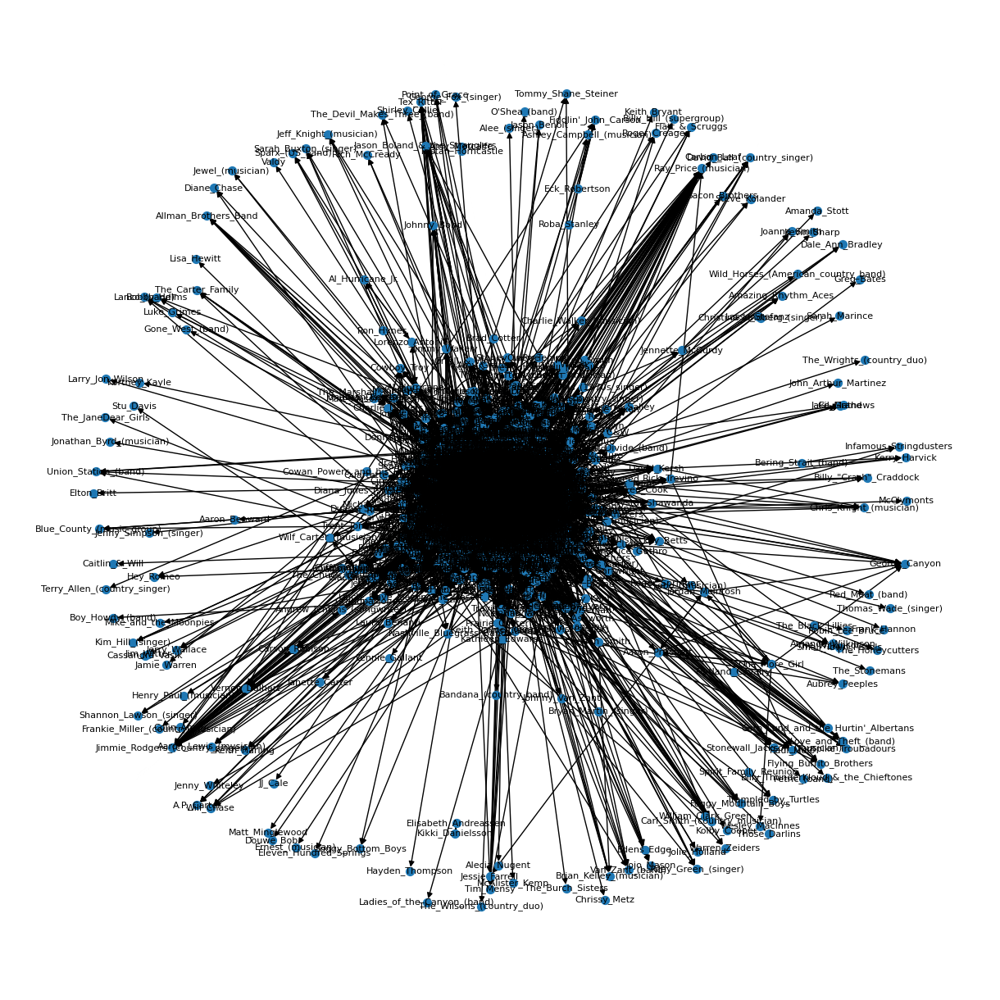

In [9]:
import matplotlib.pyplot as plt
import networkx as nx

# Assuming G is your graph (or G_largest if you're working with the largest component)
plt.figure(figsize=(12, 12))  # Optional: Set figure size for better visualization

# Draw the graph with labels, small node size, and smaller font size for readability
nx.draw(G, with_labels=True, node_size=50, font_size=8)

# Show the plot
plt.show()


Part 3: Visualizing the networks
Exercise: Let's build a simple visualization of the network

1. For the sake of the visualisation, let's convert our network to undirected graph (tip: There is a NetworkX command to help you).

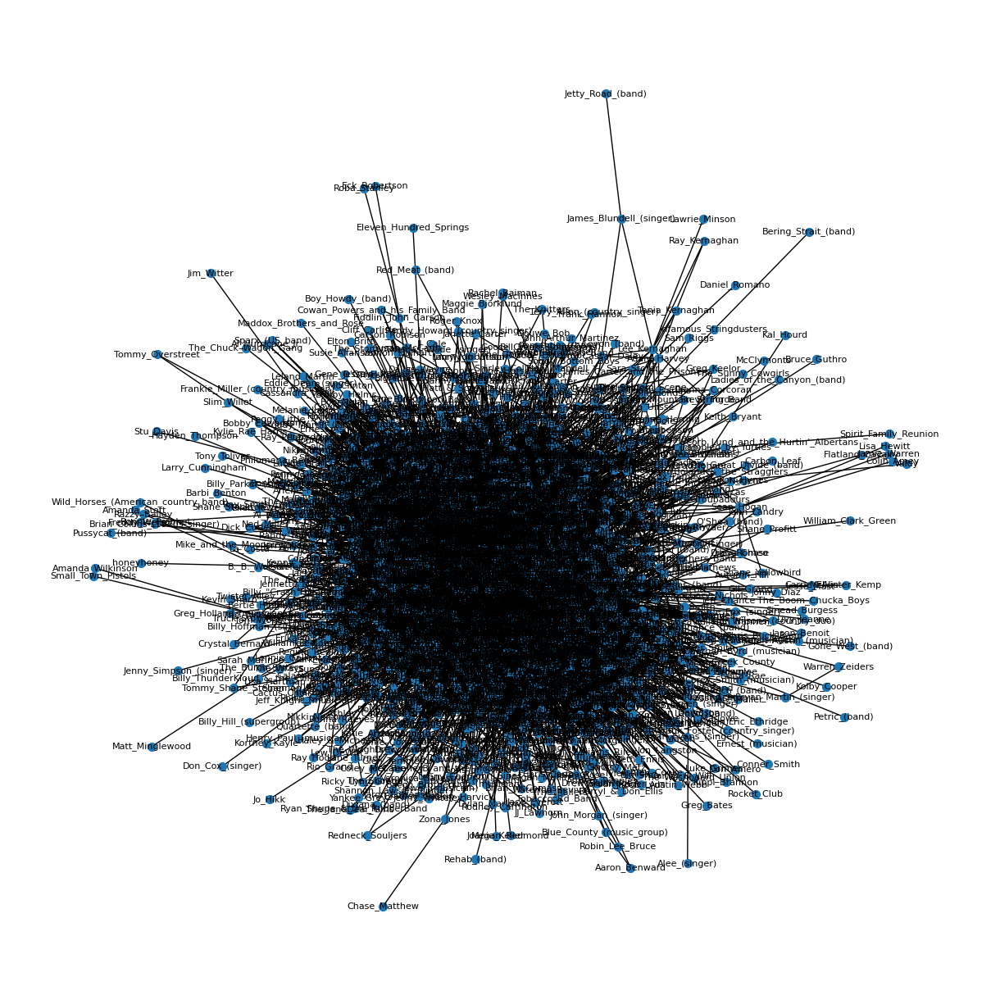

In [18]:
import networkx as nx
import matplotlib.pyplot as plt

# Create an empty undirected graph
G_undirected_manual = nx.Graph()

# Add nodes from G_largest (the largest component of the original directed graph)
G_undirected_manual.add_nodes_from(G_largest.nodes())

# Add undirected edges by iterating over edges in G_largest
for u, v in G_largest.edges():
    if not G_undirected_manual.has_edge(u, v) and not G_undirected_manual.has_edge(v, u):
        G_undirected_manual.add_edge(u, v)

# Visualize the manually created undirected graph
plt.figure(figsize=(12, 12))  # Adjust the figure size if necessary
nx.draw(G_undirected_manual, with_labels=True, node_size=50, font_size=8)

# Show the plot
plt.show()


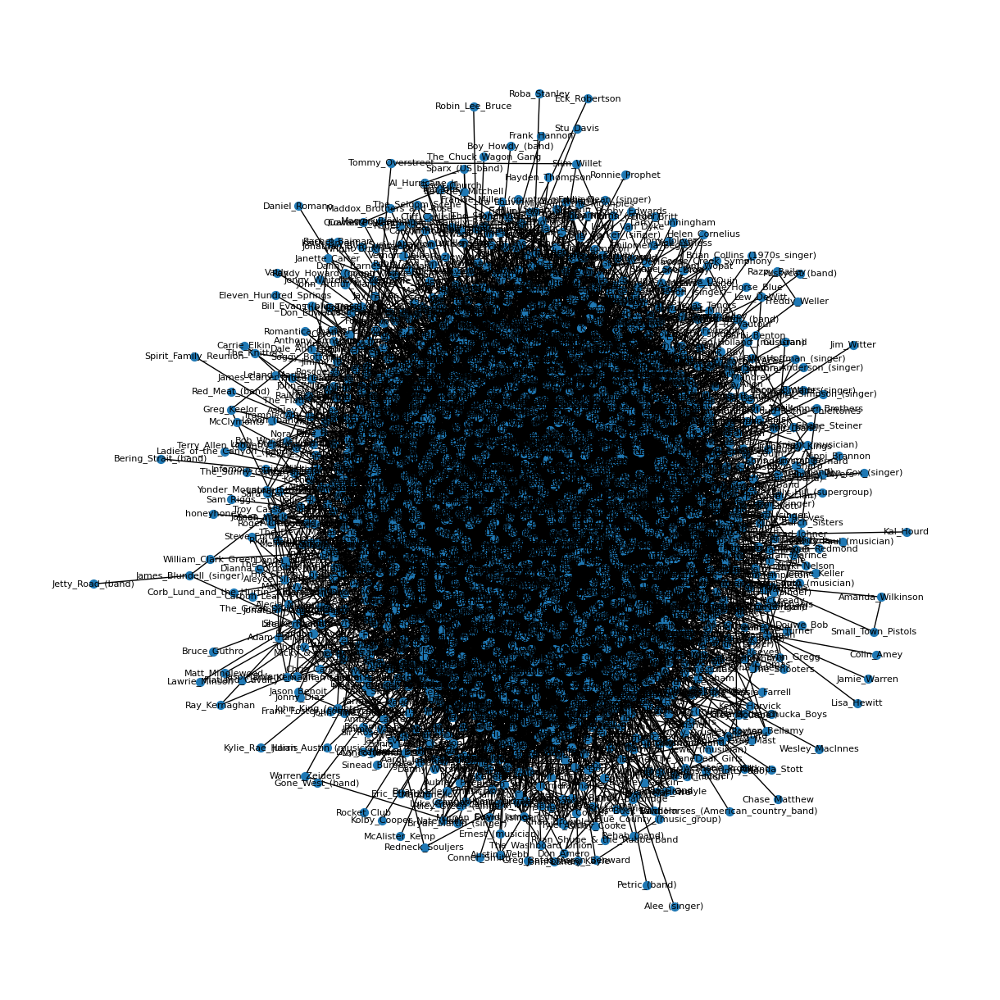

In [19]:
import networkx as nx
import matplotlib.pyplot as plt

# Create an empty undirected graph
G_undirected_manual = nx.Graph()

# Add nodes from G_largest (the largest component of the original directed graph)
G_undirected_manual.add_nodes_from(G_largest.nodes())

# Add undirected edges by iterating over edges in G_largest
for u, v in G_largest.edges():
    if not G_undirected_manual.has_edge(u, v) and not G_undirected_manual.has_edge(v, u):
        G_undirected_manual.add_edge(u, v)

# Visualize the undirected graph using Kamada-Kawai layout
plt.figure(figsize=(12, 12))  # Optional: Adjust the figure size
nx.draw_kamada_kawai(G_undirected_manual, with_labels=True, node_size=50, font_size=8)

# Show the plot
plt.show()


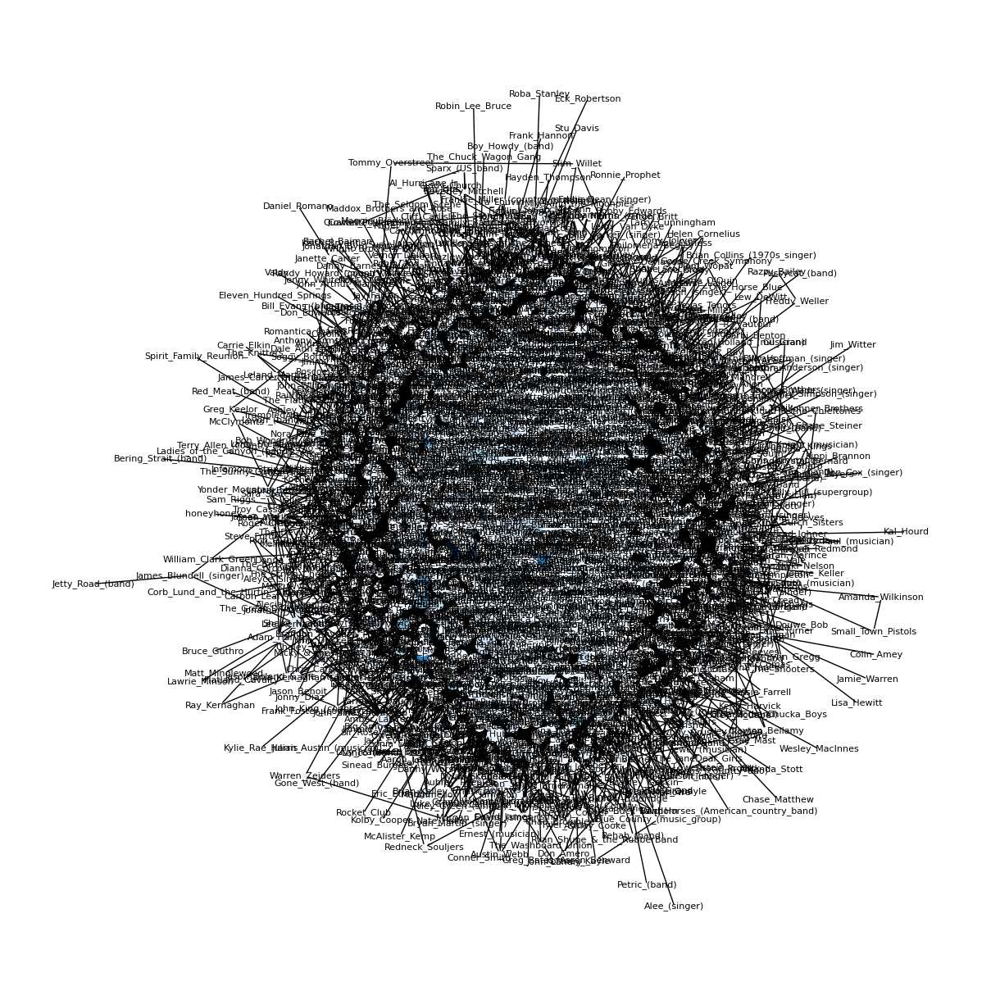

In [23]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# Create an empty undirected graph
G_undirected_manual = nx.Graph()

# Add nodes from G_largest along with their attributes
for node, data in G_largest.nodes(data=True):
    G_undirected_manual.add_node(node, **data)

# Add undirected edges by iterating over edges in G_largest
for u, v in G_largest.edges():
    if not G_undirected_manual.has_edge(u, v) and not G_undirected_manual.has_edge(v, u):
        G_undirected_manual.add_edge(u, v)

# Set up node sizes based on degree (scale up by multiplying by a constant, e.g., 10)
node_sizes = [G_undirected_manual.degree(n) * 10 for n in G_undirected_manual.nodes()]

# Set up node colors based on the 'content_length' attribute and normalize
# Use a default value if 'content_length' is missing
node_colors = [G_undirected_manual.nodes[n].get('content_length', 0) for n in G_undirected_manual.nodes()]
node_colors_normalized = (node_colors - np.min(node_colors)) / (np.max(node_colors) - np.min(node_colors))  # Normalize

# Plot the graph with Kamada-Kawai layout, customized node sizes and colors
plt.figure(figsize=(12, 12))
nx.draw_kamada_kawai(
    G_undirected_manual,
    with_labels=True,
    node_size=node_sizes,       # Node size based on degree
    node_color=node_colors_normalized,  # Node color based on content length
    cmap=plt.cm.Blues,          # Use a sequential colormap (e.g., Blues)
    font_size=8
)

# Show the plot
plt.show()
